# Аналитика рынка заведений общественного питания Москвы

**Цель проекта** - подготовить исследование рынка заведений общепита Москвы, найти интересные особенности и презентовать полученные результаты, которые помогут инвесторам из фонда «Shut Up and Take My Money» в подборе места для открытия нового заведения.

**Задачи проекта:**

- Загрузить данные и ознакомиться с ними;
- Предобработать данные, просмотреть дубликаты и добавить необходимые для целей исследования столбцы;
- Провести анализ рынка общепита, визуализировать результаты, выявить особенности рынка;
- Рассмотреть особенности рынка кофеен в Москве, составить рекомендации для открия кофейни;
- Сделать и оформить презентацию с результатами исследования для инвесторов.

## Шаг 1. Загрузим файл с данными и изучим общую информацию

In [1]:
#подключим нужные модули и библиотеки
import pandas as pd
import datetime as dt
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats as st
import seaborn as sns
import math as mth

In [2]:
df = pd.read_csv('/Users/daimond/Downloads/moscow_places.csv')

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


In [4]:
df.head(5)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


In [5]:
df.shape

(8406, 14)

**Вывод:**

По первому взгляду на данные, необходимо отметить следующее:
- датасет содержит 8406 строк, 14 столбцов;
- типы данных в представленном датасете - object, int64, float64.
- следует посмотреть дубликаты, есть ли они?;
- следует подумать насчет пропусков;
- всего представлено 8406 заведений;

## Шаг 2. Выполним предобработку данных

### Поищем дубликаты, посмотрим пропуски

In [6]:
print('Явных дубликатов:',df.duplicated().sum())

Явных дубликатов: 0


Проверим столбцы с названиями заведений и с адресами на наличие неявных дубликатов.

In [7]:
df['name'] = df['name'].str.lower()
df['address'] = df['address'].str.lower()

In [8]:
df[df[['name', 'address']].duplicated()]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
215,кафе,кафе,"москва, парк ангарские пруды",Северный административный округ,"ежедневно, 10:00–22:00",55.881438,37.531848,3.2,NaN,NaN,NaN,NaN,0,NaN
1511,more poke,ресторан,"москва, волоколамское шоссе, 11, стр. 2",Северный административный округ,"пн-чт 09:00–18:00; пт,сб 09:00–21:00; вс 09:00...",55.806307,37.497566,4.2,NaN,NaN,NaN,NaN,1,188.0
2420,раковарня клешни и хвосты,"бар,паб","москва, проспект мира, 118",Северо-Восточный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–01:00; вс 12:00...",55.810677,37.638379,4.4,NaN,NaN,NaN,NaN,1,150.0
3109,хлеб да выпечка,кафе,"москва, ярцевская улица, 19",Западный административный округ,NaN,55.738449,37.410937,4.1,NaN,NaN,NaN,NaN,0,276.0


Обнаружены 4 дубликата, удалим их.

In [9]:
df = df.drop_duplicates(subset=['name', 'address'], keep='last')

In [10]:
df.isnull().sum()

name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5087
avg_bill             4586
middle_avg_bill      5253
middle_coffee_cup    7867
chain                   0
seats                3610
dtype: int64

Пропуски содержатся в следующих столбцах:
- hours, с часами работы и seats, с количеством посадочных мест. Корректно заполнить пропуски в этих столбцах мы не сможем, так как эти параметры индивидуальны для каждого заведения. 
- price, отражающем категорию цен в заведении. Теоретически, можно заполнить исходя из столбца со средним счетом.
- middle_avg_bill, middle_coffee_cup. Пропуски в этих столбцах могут быть из-за отсутвия информации, а в столбце со средней ценой чашки кофе из-за того, что заведение не является кофейней.

Посмотрим, как раскиданы заведения по ценовым категориям, исходя из среднего чека:

In [11]:
pd.set_option('display.max_colwidth', 350)
df[df['avg_bill'].apply(
    lambda x: 'счёт' in str(x))][['price', 'avg_bill']].groupby('price')['avg_bill'].unique()

price
высокие          [Средний счёт:1500–2000 ₽, Средний счёт:2000–2500 ₽, Средний счёт:2100 ₽, Средний счёт:2000 ₽, Средний счёт:1500–3000 ₽, Средний счёт:2500–3000 ₽, Средний счёт:2000–3000 ₽, Средний счёт:4500–5500 ₽, Средний счёт:2500 ₽, Средний счёт:1500–5000 ₽, Средний счёт:1500–2500 ₽, Средний счёт:1500–1880 ₽, Средний счёт:5000–17000 ₽, Средний счёт:3500–400...
выше среднего    [Средний счёт:1500–1600 ₽, Средний счёт:1500 ₽, Средний счёт:1000–1500 ₽, Средний счёт:600–2000 ₽, Средний счёт:300–2000 ₽, Средний счёт:700–1500 ₽, Средний счёт:1200–1800 ₽, Средний счёт:от 1500 ₽, Средний счёт:1000–2000 ₽, Средний счёт:1200–1600 ₽, Средний счёт:1000–1300 ₽, Средний счёт:350–2400 ₽, Средний счёт:1200–1500 ₽, Средний счёт:1400–...
низкие           [Средний счёт:от 120 ₽, Средний счёт:150–300 ₽, Средний счёт:240 ₽, Средний счёт:50–300 ₽, Средний счёт:60–140 ₽, Средний счёт:140–160 ₽, Средний счёт:300 ₽, Средний счёт:450–600 ₽, Средний счёт:150–200 ₽, Средний счёт:100–180 ₽, Средний счёт:

Видим, что категории пересекаются, один и тот же размер среднего счета может быть и в одной категории и в другой, а значит, что корректно заполнить пропуски в столбце price у нас не получится. 

Также, корректно заполнить пропуски не получится и в остальных столбцах, где они есть. Таким образом, чтобы не искажать данные, следует оставить пропуски и работать с тем, что есть.

### Создадим дополнительные столбцы

#### Создадим столбец street с названиями улиц. Вытащим их из адреса.

In [12]:
df['street'] = df['address'].apply(lambda x: x.split(sep=', ')[1])

#### Создадим столбец is_24/7 с обозначением, что заведение работает ежедневно и круглосуточно (24/7)

In [13]:
df['hours'].unique()

array(['ежедневно, 10:00–22:00',
       'пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00',
       'ежедневно, 09:00–22:00', ...,
       'пн-пт 08:30–21:30; сб,вс 09:00–21:30',
       'пн-чт 13:00–22:00; пт,сб 13:00–22:30; вс 13:00–22:00',
       'пн-сб 10:30–21:30'], dtype=object)

In [14]:
df['is_24/7'] = df['hours'].str.contains('ежедневно, круглосуточно')

In [15]:
df.head(5)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,wowфли,кафе,"москва, улица дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,улица дыбенко,False
1,четыре комнаты,ресторан,"москва, улица дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица дыбенко,False
2,хазри,кафе,"москва, клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,клязьминская улица,False
3,dormouse coffee shop,кофейня,"москва, улица маршала федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица маршала федоренко,False
4,иль марко,пиццерия,"москва, правобережная улица, 1б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,правобережная улица,False


**Выводы по предобработке:**
- корректно заполнить пропуски нельзя, оставляем их;
- добавили два новых столбца - street, is_24/7.

## Шаг 3. Анализ данных

### Посмотрим, какие категории заведений представлены в данных.
Исследуем количество объектов общественного питания по категориям: рестораны, кофейни, пиццерии, бары и так далее. Построим визуализации.

In [16]:
df['category'].unique()

array(['кафе', 'ресторан', 'кофейня', 'пиццерия', 'бар,паб',
       'быстрое питание', 'булочная', 'столовая'], dtype=object)

In [17]:
category_count = df.pivot_table(
                    index='category', 
                    values='address', 
                    aggfunc='count').sort_values(by = 'address', ascending=False)
category_count.columns= ['count']
category_count

,count
category,
кафе,2377
ресторан,2041
кофейня,1413
"бар,паб",765
пиццерия,633
быстрое питание,603
столовая,315
булочная,255


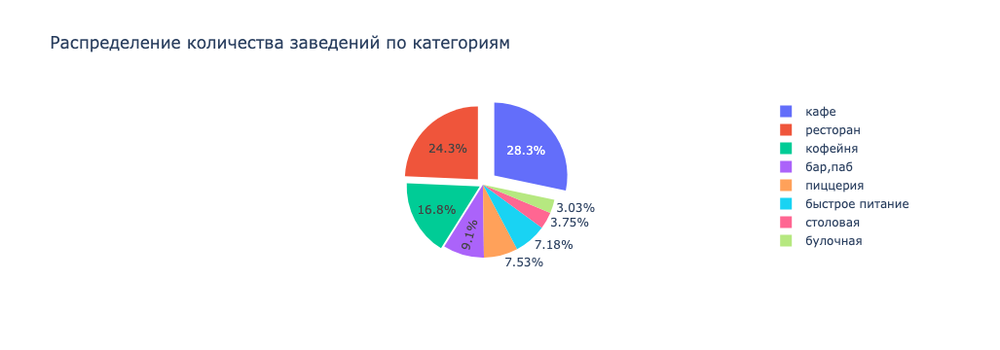

In [18]:
# построим круговую диаграму
import plotly.express as px
from plotly import graph_objects as go

fig = go.Figure(data=[go.Pie(labels=category_count.index, values=category_count['count'], pull=[0.2, 0.1, 0.05])])
fig.update_layout(title='Распределение количества заведений по категориям')          
fig.show() 

**Вывод**

Наиболее популярные заведения в Москве - кафе (28,3%), рестораны (24,3%) и кофейни (16,8%). 

При этом кафе и рестораны вместе составляют более 50% от всех заведений в Москве.

### Исследуем количество посадочных мест в местах по категориям 
Построим визуализации

Сделаем расчет через среднее и медиану, оценим как они различаются.

In [19]:
category_seats = df.pivot_table(
    index = 'category',
    values = 'seats',
    aggfunc = ['median', 'mean']).reset_index()

category_seats.columns = category_seats.columns.droplevel(1)
category_seats = category_seats.sort_values(by='median', ascending=False)

In [20]:
category_seats

,category,median,mean
6,ресторан,86.0,121.869874
0,"бар,паб",82.5,124.532051
4,кофейня,80.0,111.199734
7,столовая,75.5,99.750000
2,быстрое питание,65.0,98.891117
3,кафе,60.0,97.512315
5,пиццерия,55.0,94.496487
1,булочная,50.0,88.115646


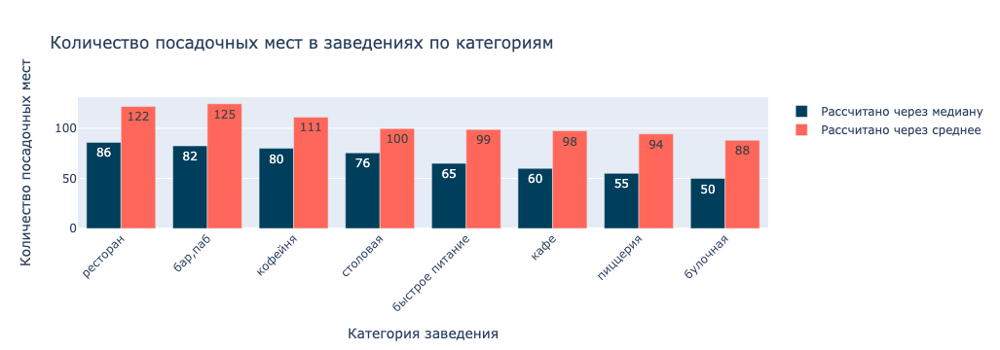

In [21]:
fig = go.Figure()

fig.add_trace(go.Bar(
    x=category_seats['category'],
    y=category_seats['median'],
    text=round(category_seats['median']),
    name='Рассчитано через медиану',
    marker_color='#003f5c',
))
fig.add_trace(go.Bar(
    x=category_seats['category'],
    y=category_seats['mean'],
    text=round(category_seats['mean']),
    name='Рассчитано через среднее',
    marker_color='#ff675a'
))

fig.update_layout(barmode='group', 
                  xaxis_tickangle=-45,
                  title='Количество посадочных мест в заведениях по категориям',
                  yaxis_title='Количество посадочных мест',
                  xaxis_title='Категория заведения')
fig.show()

**Вывод**

Рассчитанное количество посадочных мест через медиану и среднее сильно отличается. Москва большой город и заведения сильно различаются по размеру и количеству посадочных мест.

Тем не менее, наибольшее количество посадочных мест зафиксировано среди ресторанов, баров, пабов и в кофейнях.

### Рассмотрим и изобразим соотношение сетевых и несетевых заведений в датасете. 

In [22]:
chain = df.pivot_table(
    index='chain',
    values = 'name',
    aggfunc = 'count')

# chain.rename(index={0:'Несетевые', 1:'Сетевые'}, inplace= True)
chain

,name
chain,
0,5198
1,3204


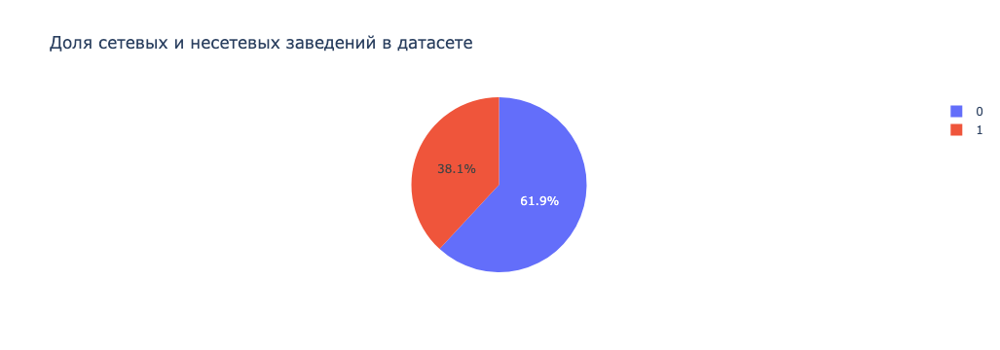

In [23]:
fig = go.Figure(
    data=[go.Pie(labels=chain.index, values=chain['name'])])

fig.update_layout(title='Доля сетевых и несетевых заведений в датасете') 

fig.show() 

**Вывод**

Большинство (62%) заведений, представленных в датасете не являются сетевыми. Доля сетевых - 38%.

### Рассмотрим, какие категории заведений чаще являются сетевыми? 

In [24]:
chain_category = df.pivot_table(
    index='category',
    values='chain',
    aggfunc='mean').sort_values(by='chain', ascending=False).reset_index()
    
chain_category['chain'] = round(chain_category['chain'],2) 

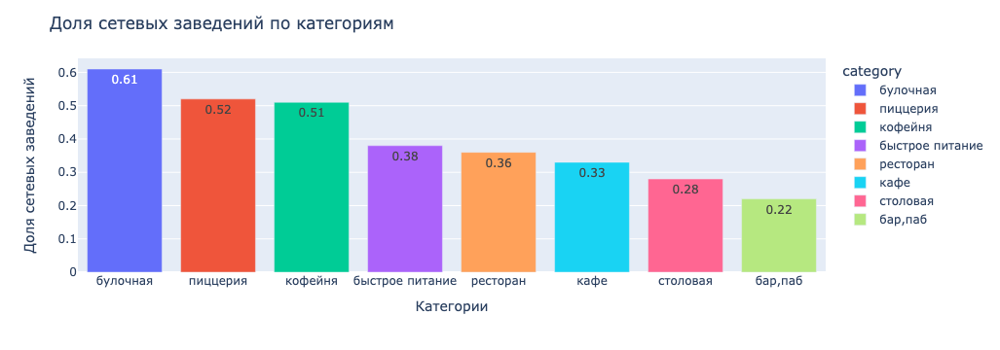

In [25]:
fig = px.bar(chain_category, x='category', y='chain', color='category', text ='chain')

fig.update_layout(title='Доля сетевых заведений по категориям',
                  xaxis_title='Категории',
                  yaxis_title='Доля сетевых заведений')

fig.update_traces(hovertemplate = 'Категория: %{x} <br>Доля сетевых: %{y}')

fig.show()

**Вывод**

Больше всего сетевых заведений среди булочных (61%), далее следуют пиццерии (52%) и кофейни (51%). Меньше всего сетевых заведений среди баров (22%).

### Найдем топ-15 популярных сетей в Москве. Проанализируем их.

In [26]:
top_15 = df.query('chain == 1').pivot_table(
    index = ['name','category'],
    values = 'address',
    aggfunc = 'count').sort_values(by='address', ascending=False).head(15).reset_index()

top_15

,name,category,address
0,шоколадница,кофейня,119
1,домино'с пицца,пиццерия,76
2,додо пицца,пиццерия,74
3,one price coffee,кофейня,71
4,яндекс лавка,ресторан,69
5,cofix,кофейня,65
6,prime,ресторан,49
7,кофепорт,кофейня,42
8,кулинарная лавка братьев караваевых,кафе,39
9,теремок,ресторан,36


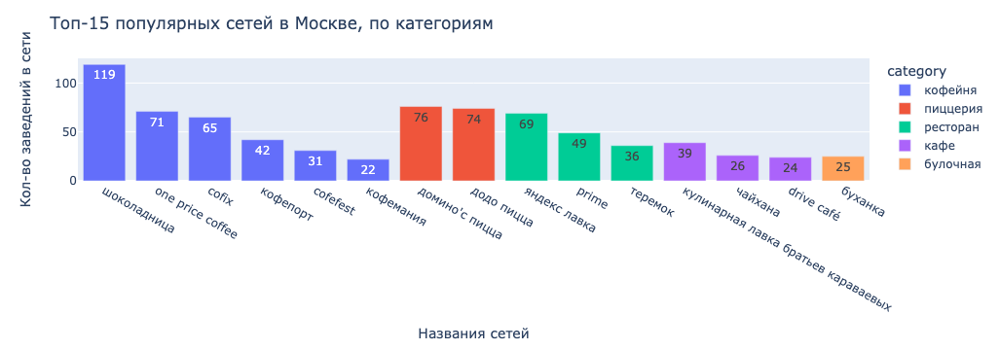

In [27]:
fig = px.bar(top_15, x='name', y='address', color='category', text ='address')

fig.update_layout(title='Топ-15 популярных сетей в Москве, по категориям',
                  xaxis_title='Названия сетей',
                  yaxis_title='Кол-во заведений в сети')
                  
fig.update_traces(hovertemplate = 'Название сети: %{x} <br>Количество заеведений: %{y}')

fig.show()

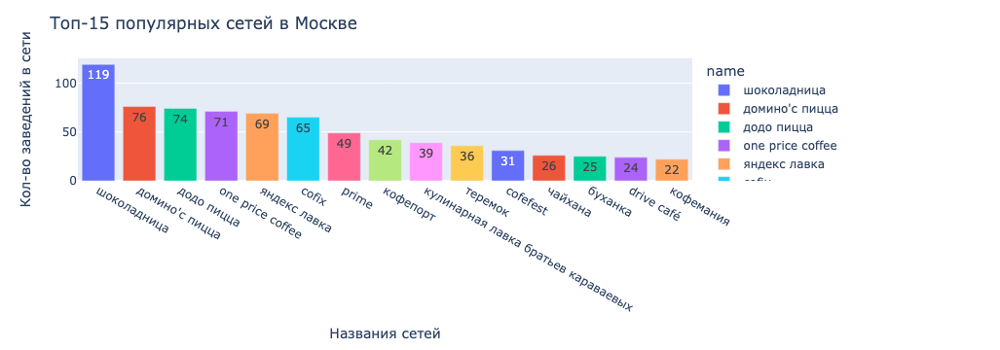

In [28]:
fig = px.bar(top_15, x='name', y='address', color='name', text ='address')

fig.update_layout(title='Топ-15 популярных сетей в Москве',
                  xaxis_title='Названия сетей',
                  yaxis_title='Кол-во заведений в сети')

fig.update_traces(hovertemplate = 'Название сети: %{x} <br>Количество заеведений: %{y}')

fig.show()

**Выводы**

- Cреди сетей с большим отрывом лидирует Шоколадница включающая в себя 120 заведений;
- Сразу две сети пиццерий попали в топ-15 - Домино'с Пицца и Додо, расположившись на 2 и 3 месте. Это единственные представители пиццерий в рейтинге;
- Среди наиболее популярных ресторанных сетей - Яндекс.Лавка, однако на практике, лавка представлена дарксторами, а не ресторанами в привычном понимании. Поэтому есть вопросы к корректности ее нахождения в рейтинге.
- Среди кафе наиболее популряная сеть - Кулинарная лавка Братьев Караваевых. 
- Только одна булочная попала в рейтинг - Буханка, с 25 заведениями.

### Выясним, какие административные районы Москвы присутствуют в датасете? 


In [29]:
district_count = df.pivot_table(
    index = ['district','category'],
    values = 'address',
    aggfunc = 'count').sort_values(by='address', ascending=False).reset_index()

district_count

,district,category,address
0,Центральный административный округ,ресторан,670
1,Центральный административный округ,кафе,464
2,Центральный административный округ,кофейня,428
3,Центральный административный округ,"бар,паб",364
4,Юго-Восточный административный округ,кафе,282
...,...,...,...
67,Северо-Западный административный округ,"бар,паб",23
68,Северо-Западный административный округ,столовая,18
69,Юго-Западный административный округ,столовая,17
70,Юго-Восточный административный округ,булочная,13


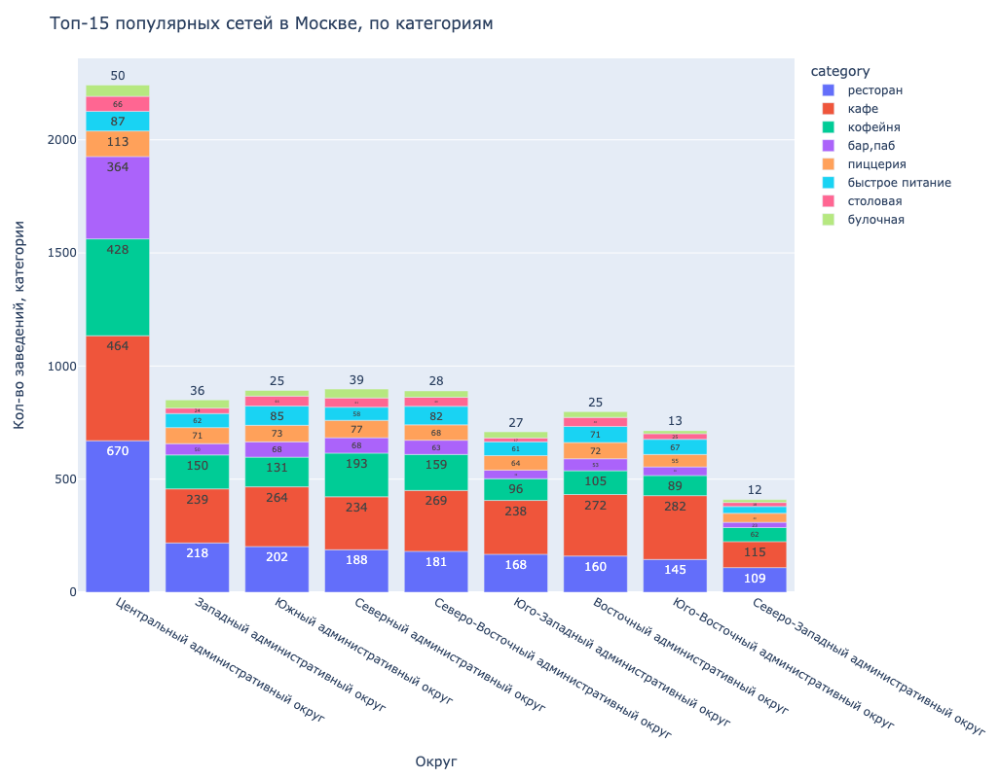

In [30]:
fig = px.bar(district_count, x='district', y='address', color='category', text ='address', height=800)

fig.update_layout(title='Топ-15 популярных сетей в Москве, по категориям',
                  xaxis_title='Округ',
                  yaxis_title='Кол-во заведений, категории')

fig.update_traces(hovertemplate = 'Округ: %{x} <br>Количество заеведений: %{y}')

fig.show()

**Выводы**

- Как и предполагалось, наибольшее количество заведений представлено в ЦАО. Наиболее популярный тип заведений в ЦАО - рестораны. 
- Высокое и примерно равное количество заведений заметно в ЗАО, ЮАО, САО и СВАО. 
- В остальных округах заведений заметно меньше, округ с наименьшим количеством заведений - СЗАО.
- В целом, во всех округах, кроме ЦАО, наиболее популярная категория заведений - кафе. Также категории заведений во всех округах, кроме ЦАО, распределены примерно в одинаковых пропорциях.

### Рассмотрим распределение средних рейтингов по категориям заведений. 

In [31]:
# посмотрим на рейтинг в общем датасете
df['rating'].describe()

count    8402.000000
mean        4.230017
std         0.470320
min         1.000000
25%         4.100000
50%         4.300000
75%         4.400000
max         5.000000
Name: rating, dtype: float64

Минимальная оценка - 1, максимальная - 5, значит система пятибальная. Среднее лежит в районе 4,2.

In [32]:
rating_cat = df.pivot_table(
    index = 'category',
    values = 'rating',
    aggfunc = 'mean').sort_values(by='rating', ascending=False).reset_index()

rating_cat['rating'] = round(rating_cat['rating'],2)

rating_cat

,category,rating
0,"бар,паб",4.39
1,пиццерия,4.30
2,ресторан,4.29
3,кофейня,4.28
4,булочная,4.27
5,столовая,4.21
6,кафе,4.12
7,быстрое питание,4.05


In [33]:
rat_cat = df[['category','rating']]
rat_cat = rat_cat.pivot_table(
    index = rat_cat.index,
    columns = 'category',
    values = 'rating')

sorted_index = rat_cat.median().sort_values().index
df_sorted=rat_cat[sorted_index]

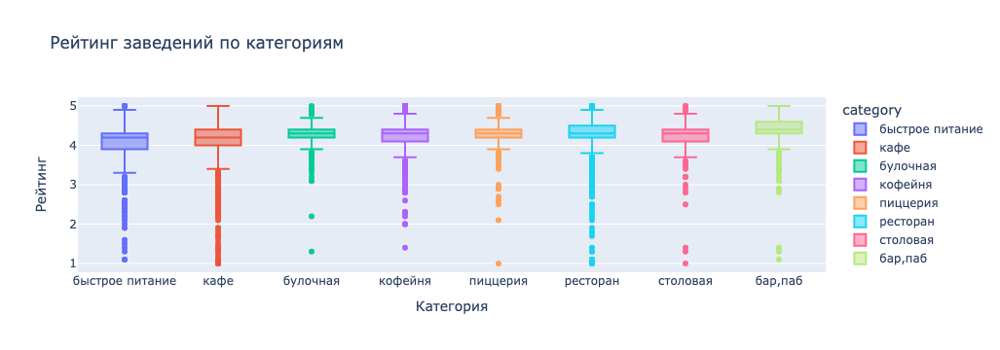

In [34]:
fig = px.box(df_sorted,
             color='category', 
             title = 'Рейтинг заведений по категориям')

fig.update_layout(xaxis_title = 'Категория',
                  yaxis_title = 'Рейтинг')

fig.show()

**Выводы:**

- Только у кафе и баров размах значений доходит до 5 баллов, у остальных категорий такие оценки считаются выбросами;
- Кафе, рестораны и заведения фаст-фуда отличаются большим количеством выбросов с негативными оценками;
- Наилучшие оценки у баров, пабов, пиццерий и ресторанов;
- Худшие оценки характерны для заведений фаст-фуда.

### Построим фоновую картограмму (хороплет) со средним рейтингом заведений каждого района. 

In [35]:
# подключим модуль для работы с JSON-форматом
import json


with open('/Users/daimond/Downloads/admin_level_geomap.geojson', 'r') as f:
    geo_json = json.load(f)


In [36]:
rating_geo = df.pivot_table(
    index = 'district',
    values = 'rating',
    aggfunc = 'mean').sort_values(by='rating', ascending=False).reset_index()

rating_geo['rating'] = round(rating_geo['rating'],2)

rating_geo

,district,rating
0,Центральный административный округ,4.38
1,Северный административный округ,4.24
2,Северо-Западный административный округ,4.21
3,Южный административный округ,4.18
4,Западный административный округ,4.18
5,Восточный административный округ,4.17
6,Юго-Западный административный округ,4.17
7,Северо-Восточный административный округ,4.15
8,Юго-Восточный административный округ,4.10


In [37]:
# импортируем карту и хороплет
from folium import Map, Choropleth

# загружаем JSON-файл с границами округов Москвы
state_geo = '/Users/daimond/Downloads/admin_level_geomap.geojson'
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создадим карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

# создадим хороплет с помощью конструктора Choropleth и добавим его на карту
Choropleth(
    geo_data=state_geo,
    data=rating_geo,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний рейтинг заведений по районам',
).add_to(m)


m

### Отобразим все заведения датасета на карте с помощью кластеров средствами библиотеки folium.

In [38]:
# импортируем карту и маркер
from folium import Map, Marker
# импортируем кластер
from folium.plugins import MarkerCluster

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles="Cartodb Positron")
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
df.apply(create_clusters, axis=1)

# выводим карту
m

**Выводы**

Самые высокие рейтинги заведений в ЦАО, наименьшие - в СВАО и ЮВАО. 

### Найдем топ-15 улиц по количеству заведений. 
Построим график распределения количества заведений и их категорий по этим улицам.

Найдем топ-15 улиц без распределения по категориям. Потом посмотрим общепит каких категорий на них представлен.

In [39]:
top_streets = df.pivot_table(
    index = 'street',
    values = 'address',
    aggfunc = 'count').sort_values(by='address', ascending=False).reset_index().head(15)

top_streets

,street,address
0,проспект мира,183
1,профсоюзная улица,122
2,проспект вернадского,108
3,ленинский проспект,107
4,ленинградский проспект,95
5,дмитровское шоссе,88
6,каширское шоссе,77
7,варшавское шоссе,76
8,ленинградское шоссе,70
9,мкад,65


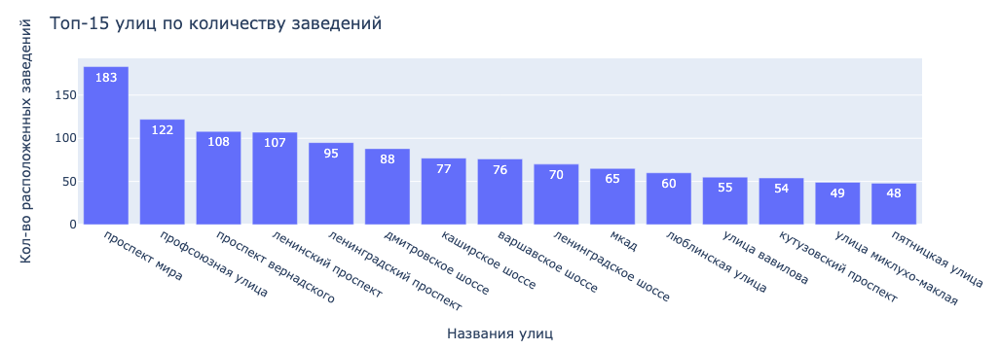

In [40]:
fig = px.bar(top_streets, x='street', y='address', text ='address')

fig.update_layout(title='Топ-15 улиц по количеству заведений',
                  xaxis_title='Названия улиц',
                  yaxis_title='Кол-во расположенных заведений')

fig.update_traces(hovertemplate = 'Улица: %{x} <br>Количество: %{y}')

fig.show()

Среди самых популярных улиц сразу 4 проспекта - проспект Мира, Вернадского, Ленинский и Ленинградский, а также Профсоюзная улица.

In [41]:
top_names = top_streets['street'].tolist()
# top_names

top_streets_category = df.query('street in @top_names')
top_streets_category.street.unique()

array(['дмитровское шоссе', 'мкад', 'ленинградское шоссе',
       'проспект мира', 'ленинградский проспект', 'кутузовский проспект',
       'ленинский проспект', 'пятницкая улица', 'проспект вернадского',
       'улица вавилова', 'профсоюзная улица', 'люблинская улица',
       'улица миклухо-маклая', 'варшавское шоссе', 'каширское шоссе'],
      dtype=object)

In [42]:
top_streets_category = top_streets_category.pivot_table(
    index=['street', 'category'],
    values='address',
    aggfunc = 'count').sort_values(by='address', ascending=False).reset_index()

top_streets_category = top_streets_category.rename(columns={'address':'count'})


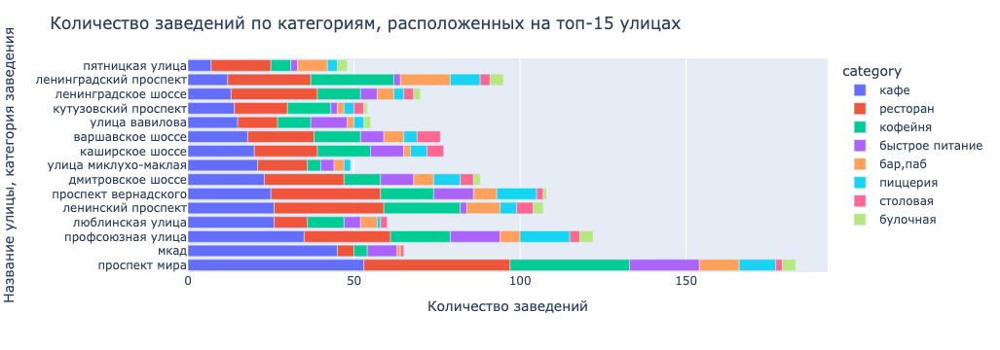

In [43]:
fig = px.bar(top_streets_category, 
             x='count', y='street', 
             color='category')

fig.update_layout(title='Количество заведений по категориям, расположенных на топ-15 улицах',
                  xaxis_title='Количество заведений',
                  yaxis_title='Название улицы, категория заведения')
                  
fig.show()

**Вывод**

На топ-15 улиц стабильно доминируют такие категории заведений, как рестораны, кафе и кофейни.

### Найдем улицы, на которых находится только один объект общепита. 

In [44]:
one_point_street = df.pivot_table(
    index = 'street',
    values = 'address',
    aggfunc = 'count').sort_values(by='address', ascending=False).reset_index()

one_point_street = one_point_street.query('address == 1')

one_point_street = one_point_street['street'].tolist()

Получили 458 заведений, которые являются единственными точками общепита, расположенными на улице.

In [45]:
one_point_street_all = df.query('street in @one_point_street')

In [46]:
one_point_street_dist = one_point_street_all.pivot_table(
    index='district',
    values='address',
    aggfunc='count').reset_index().sort_values(by='address')

one_point_street_dist

,district,address
7,Юго-Западный административный округ,18
4,Северо-Западный административный округ,19
1,Западный административный округ,35
6,Юго-Восточный административный округ,39
8,Южный административный округ,43
2,Северный административный округ,51
0,Восточный административный округ,52
3,Северо-Восточный административный округ,55
5,Центральный административный округ,145


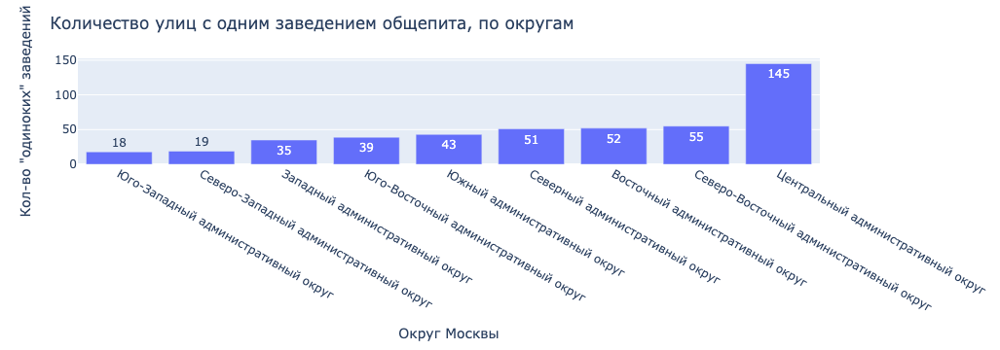

In [47]:
fig = px.bar(one_point_street_dist, x='district', y='address', text ='address')

fig.update_layout(title='Количество улиц с одним заведением общепита, по округам',
                  xaxis_title='Округ Москвы',
                  yaxis_title='Кол-во "одиноких" заведений')

fig.update_traces(hovertemplate = 'Округ: %{x} <br>Количество: %{y}')
                  
fig.show()

**Вывод**

Больше всего улиц с одним заведением общепита в ЦАО. Это логично, так как улицы в центре зачастую меньше по размеру, а плотность различных офисов/магазинов и т.д. выше.

Посмотрим, как расположены "одинокие" заведения в разрезе категорий.

In [48]:
one_point_street_category = one_point_street_all.pivot_table(
    index=['district', 'category'], 
    values='address',
    aggfunc='count').reset_index().sort_values(by='address', ascending=False)

one_point_street_category = one_point_street_category.rename(columns={'address':'count'})
one_point_street_category

,district,category,count
39,Центральный административный округ,кафе,38
42,Центральный административный округ,ресторан,36
40,Центральный административный округ,кофейня,34
36,Центральный административный округ,"бар,паб",23
59,Южный административный округ,кафе,22
...,...,...,...
57,Южный административный округ,булочная,1
14,Западный административный округ,столовая,1
30,Северо-Западный административный округ,"бар,паб",1
45,Юго-Восточный административный округ,быстрое питание,1


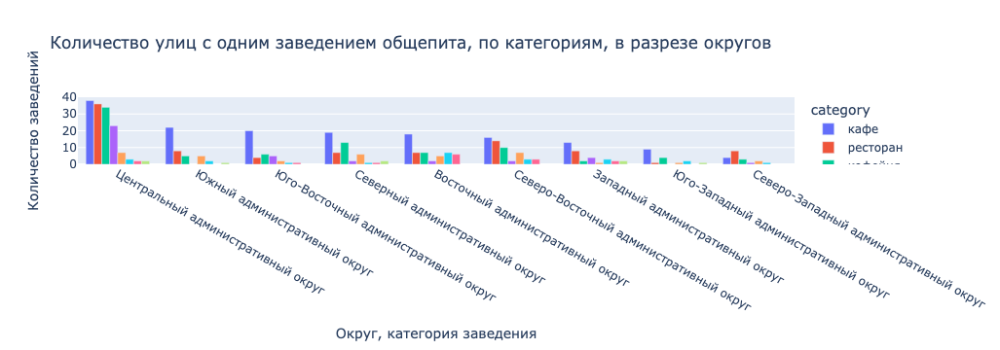

In [49]:
fig = px.bar(one_point_street_category, 
             x='district', 
             y= 'count', 
             title = 'Количество улиц с одним заведением общепита, по категориям, в разрезе округов',
             color='category', barmode='group')

fig.update_layout(xaxis_title = 'Округ, категория заведения',
                  yaxis_title = 'Количество заведений')

fig.show()

**Выводы**

- Большинство "одиноких" заведений - кафе, причем категория кафе лидирует везде, кроме СЗАО, там большинство "одиноких" заедений принадлежат категории рестораны.
- Кроме ЦАО, много одиноких заведений из разных категорий наблюдается в СВАО.

### Проанализируем средние чеки в заведениях. Посмотрим на распределение по районам, категориям. Построим хороплет.

In [50]:
avg_bill_dist = df.pivot_table(
    index='district',
    values='middle_avg_bill',
    aggfunc='median').reset_index().sort_values(by='middle_avg_bill', ascending=False)

avg_bill_dist

,district,middle_avg_bill
1,Западный административный округ,1000.0
5,Центральный административный округ,1000.0
4,Северо-Западный административный округ,700.0
2,Северный административный округ,650.0
7,Юго-Западный административный округ,600.0
0,Восточный административный округ,575.0
3,Северо-Восточный административный округ,500.0
8,Южный административный округ,500.0
6,Юго-Восточный административный округ,450.0


Видно, что наиболее высокий средний чек в ЦАО и ЗАО, наименьший в ЮВАО.

**Построим фоновую картограмму (хороплет) со средним чеком для каждого района.**

In [51]:
# загружаем JSON-файл с границами округов Москвы
state_geo = '/Users/daimond/Downloads/admin_level_geomap.geojson'
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создадим карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

# создадим хороплет с помощью конструктора Choropleth и добавим его на карту
Choropleth(
    geo_data=state_geo,
    data=avg_bill_dist,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний чек в заведениях по районам',
).add_to(m)


m

In [52]:
avg_bill_cat = df.pivot_table(
    index='category',
    values='middle_avg_bill',
    aggfunc='median').reset_index().sort_values(by='middle_avg_bill', ascending=False)

avg_bill_cat

,category,middle_avg_bill
0,"бар,паб",1250.0
6,ресторан,1250.0
5,пиццерия,600.0
3,кафе,550.0
1,булочная,450.0
4,кофейня,400.0
2,быстрое питание,375.0
7,столовая,300.0


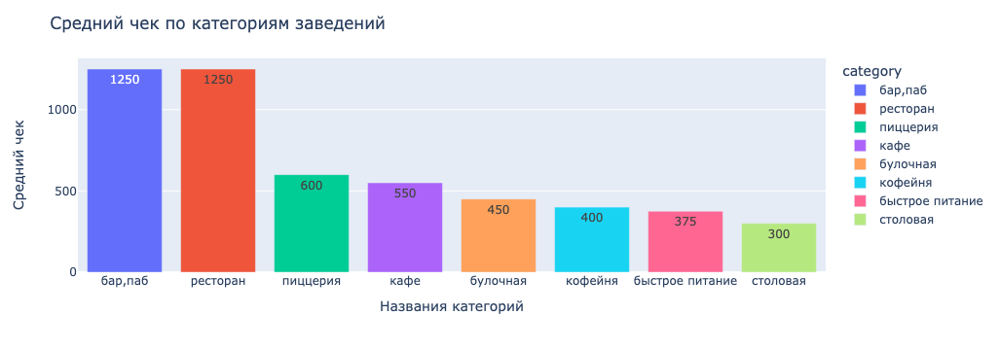

In [53]:
fig = px.bar(avg_bill_cat, x='category', y='middle_avg_bill', color='category', text ='middle_avg_bill')

fig.update_layout(title='Средний чек по категориям заведений',
                  xaxis_title='Названия категорий',
                  yaxis_title='Средний чек')
                  
fig.show()

**Вывод**

Наибольший средний чек заметен в ресторанах и барах,пабах. Меньше всего средний чек в столовых и фаст-фудных.

### Выводы по шагу 3.

В шаге 3 мы рассматривали различные аспекты рынка общепита в Москве, проводили расчеты, строили графики. 

Основные тезисы:

1. В москве существуют 8 категорий заведений: кафе, ресторан, кофейня, пиццерия, бар,паб, быстрое питание, булочная, столовая. Наиболее популярные заведения в Москве - кафе (28,3%), рестораны (24,3%) и кофейни (16,8%). При этом кафе и рестораны вместе составляют более 50% от всех заведений в Москве.
2. Количество посадочных мест варьируется от заведения к заведению. Тем не менее, для ресторанов, баров,пабов и кофеен характерное медианное значение посадочных мест в заведении - около 80. Эти категории заведений являются лидерами по числу посадочных мест. Меньше всего посадочных мест в булочных и пиццериях (медианное значение 50 и 55 соответсвенно).
3. Всего в датасете представлено 8406 заведений. При этом, 3205 заведений являются сетевыми (38.1%), 5201 (61,9%) в сеть не входят.
4. Больше всего сетевых заведений среди булочных (61%), далее следуют пиццерии (52%) и кофейни (51%). Меньше всего сетевых заведений среди баров (22%).
5. Был сформирован топ-15 сетей общепита в Москве, топ-15 включает сети: 'Шоколадница', 'Домино'с Пицца', 'Додо Пицца', 'One Price Coffee', 'Яндекс Лавка', 'Cofix', 'Prime', 'КОФЕПОРТ', 'Кулинарная лавка братьев Караваевых', 'Теремок', 'CofeFest', 'Чайхана', 'Буханка', 'Drive Café', 'Кофемания'. Также, стоит отметить, что среди сетей с большим отрывом лидирует 'Шоколадница', включающая в себя 120 заведений.
6. Были рассмотрены 9 округов Москвы. Наибольшее число заведений общепита расположились в центре Москвы, в остальных округах точек общепита примерно вдвое меньше.
7. Были рассмотрены рейтинги заведений. Средний рейтинг всех заведений лежит в районе 4,2 балла. Наилучшие оценки у баров,пабов, пиццерий и ресторанов, плохие оценки характерны для заведений фаст-фуда. В географическом разрезе, самые высокие рейтинги заведений характерны для ЦАО, низкие рейтинги для СВАО и ЮВАО.
8. Был построен топ-15 улиц по количеству заведений. На данных улицах стабильно доминируют такие категории заведений, как рестораны, кафе и кофейни. Также, стоит отметить, что улицы, попавшие в топ-15 зачастую являются крупными артериями города и на них закономерно много заведений.
9. Были рассмотрены улицы, на которых расположен только один объект общепита. Таких объектов оказалось 458. Больше всего улиц с одним заведением общепита в ЦАО. Большинство "одиноких" заведений - кафе, причем категория кафе лидирует везде, кроме СЗАО, там большинство "одиноких" заедений принадлежат категории рестораны. 
10. Был рассмотрен средний чек в заведении в разрезе района и категории. Наиболее высокий средний чек в ЦАО и ЗАО, наименьший в ЮВАО. По категориям - наибольший средний чек заметен в ресторанах и барах,пабах. Меньше всего средний чек в столовых и фаст-фудных.


## Шаг 4. Детализируем исследование: открытие кофейни

### Узнаем, сколько всего кофеен в датасете? В каких районах их больше всего, каковы особенности их расположения?

In [54]:
coffee_house = df.query('category == "кофейня"')
print('Всего кофеен в датасете:',len(coffee_house))

Всего кофеен в датасете: 1413


In [55]:
coffee_dist = coffee_house.pivot_table(
    index='district',
    values='address',
    aggfunc='count').reset_index().sort_values(by='address', ascending=False)

coffee_dist = coffee_dist.rename(columns={'address':'count'})
coffee_dist

,district,count
5,Центральный административный округ,428
2,Северный административный округ,193
3,Северо-Восточный административный округ,159
1,Западный административный округ,150
8,Южный административный округ,131
0,Восточный административный округ,105
7,Юго-Западный административный округ,96
6,Юго-Восточный административный округ,89
4,Северо-Западный административный округ,62


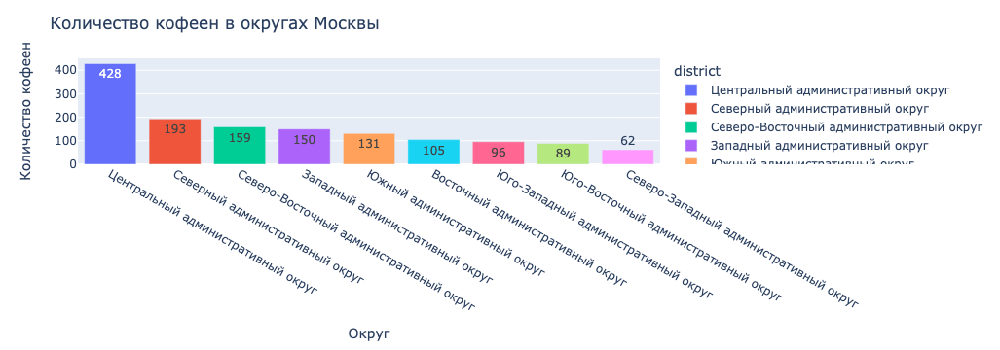

In [56]:
fig = px.bar(coffee_dist, x='district', y='count', color='district', text ='count')

fig.update_layout(title='Количество кофеен в округах Москвы',
                  xaxis_title='Округ',
                  yaxis_title='Количество кофеен')
                  
fig.show()

**Выводы**

- Общее количество кофеен в датасете - 1413
- Больше всего кофеен находится в ЦАО, меньше всего в СЗАО и ЮВАО. Основная концетрация кофеен в ЦАО обусловлена тем, что целевая аудитория находится именно в центре, в силу деловой активности. В спальных районах формат кофеен не сильно привлекает потребителей.

### Посмотрим, есть ли круглосуточные кофейни?

In [57]:
coffee_24 = coffee_house.groupby('is_24/7').agg({'address': 'count'}).reset_index()
coffee_24 = coffee_24.rename(columns={'address':'count'})


def hours(x):
    if x == False:
        return "Не круглосуточные"
    else:
        return "Круглосуточные"
    
coffee_24['is_24/7'] = coffee_24['is_24/7'].apply(hours)
coffee_24

,is_24/7,count
0,Не круглосуточные,1339
1,Круглосуточные,59


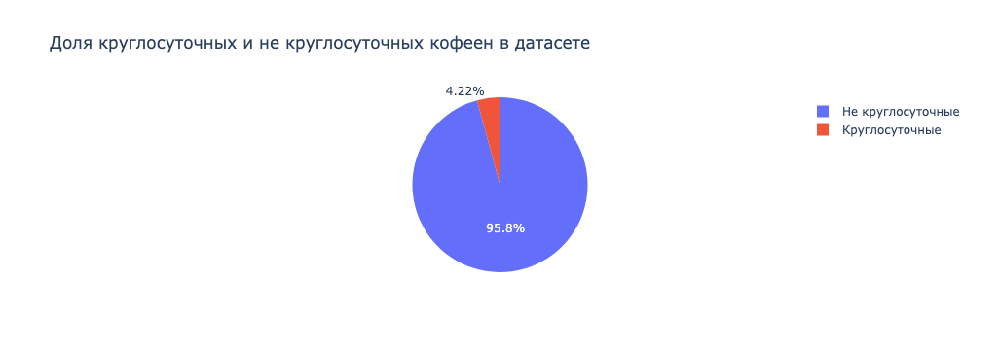

In [58]:
coffee_24

fig = go.Figure(
    data=[go.Pie(labels=coffee_24['is_24/7'], values=coffee_24['count'])])

fig.update_layout(title='Доля круглосуточных и не круглосуточных кофеен в датасете') 

fig.show() 

**Вывод:**
    
Посколько кофе нехарактерный напиток для ночного времени, то доля круглосуточных кофеен невелика и составляет всего 4,2%, 96% кофеен работают исключительно в дневное время.

### Изучим, какие у кофеен рейтинги? Как они распределяются по районам?

In [59]:
coffee_house.head(1)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
3,dormouse coffee shop,кофейня,"москва, улица маршала федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.48886,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица маршала федоренко,False


In [60]:
coffee_house['rating'].describe()

count    1413.000000
mean        4.277282
std         0.372250
min         1.400000
25%         4.100000
50%         4.300000
75%         4.400000
max         5.000000
Name: rating, dtype: float64

Средний рейтинг всех представленных кофеен - 4,3.

In [61]:
coffee_house.groupby('district').agg({'rating': 'describe'}).reset_index()

district rating                           \
                                            count      mean       std  min   
0         Восточный административный округ  105.0  4.282857  0.376077  3.0   
1          Западный административный округ  150.0  4.195333  0.361454  2.3   
2          Северный административный округ  193.0  4.291710  0.444097  2.0   
3  Северо-Восточный административный округ  159.0  4.216981  0.425487  1.4   
4   Северо-Западный административный округ   62.0  4.325806  0.430377  2.0   
5       Центральный административный округ  428.0  4.336449  0.256948  2.3   
6     Юго-Восточный административный округ   89.0  4.225843  0.514456  2.3   
7      Юго-Западный административный округ   96.0  4.283333  0.304930  3.3   
8             Южный административный округ  131.0  4.232824  0.388576  2.0   

                           
     25%  50%    75%  max  
0  4.100  4.3  4.400  5.0  
1  4.025  4.2  4.375  5.0  
2  4.100  4.3  4.500  5.0  
3  4.100  4.3  4.400  5.0  
4  4.200  4.3  4.500  5.0  
5  4.200  4.3  4.400  5.0  
6  4.100  4.3  4.500  5.0  
7  4.100  4.3  4.500  5.0  
8  4.100  4.3  4.400  5.0

In [62]:
rat_coffee = coffee_house[['district','rating']]
rat_coffee = rat_coffee.pivot_table(
    index = rat_coffee.index,
    columns = 'district',
    values = 'rating')

sorted_index_2 = rat_coffee.median().sort_values().index
coffee_sorted=rat_coffee[sorted_index_2]

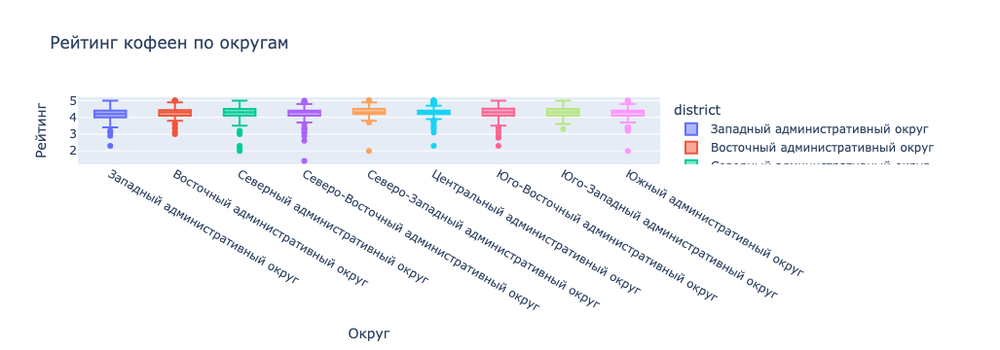

In [63]:
fig = px.box(coffee_sorted,
             color='district', 
             title = 'Рейтинг кофеен по округам')

fig.update_layout(xaxis_title = 'Округ',
                  yaxis_title = 'Рейтинг')
fig.show()

**Вывод**

Средняя оценка кофеен во всех округах выше 4. Больше всего негативных оценок наблюдается в СВАО, ЮВАО.

### Рассмотрим, на какую стоимость чашки капучино стоит ориентироваться при открытии?

Так как в датасете много пропусков в столбце со средней чашкой кофе, то избавимся от пропусков.

In [64]:
coffee_house_cup = coffee_house.query('middle_coffee_cup.notnull()')

In [65]:
coffee_house_cup['middle_coffee_cup'].describe()

count     521.000000
mean      175.055662
std        89.753009
min        60.000000
25%       124.000000
50%       170.000000
75%       225.000000
max      1568.000000
Name: middle_coffee_cup, dtype: float64

In [66]:
coffee_house_cup.groupby('district').agg({'middle_coffee_cup': 'describe'})

middle_coffee_cup              \
                                                    count        mean   
district                                                                
Восточный административный округ                     42.0  174.023810   
Западный административный округ                      49.0  189.938776   
Северный административный округ                      76.0  165.789474   
Северо-Восточный административный округ              60.0  165.333333   
Северо-Западный административный округ               21.0  165.523810   
Центральный административный округ                  162.0  187.518519   
Юго-Восточный административный округ                 34.0  151.088235   
Юго-Западный административный округ                  34.0  184.176471   
Южный административный округ                         43.0  158.488372   

                                                                          \
                                                std   min     25%    50%   
district                                                                   
Восточный административный округ         225.384710  60.0  106.25  135.0   
Западный административный округ           74.227243  60.0  130.00  189.0   
Северный административный округ           62.668081  60.0  133.00  159.0   
Северо-Восточный административный округ   63.644049  60.0  123.00  162.5   
Северо-Западный административный округ    60.797713  60.0  124.00  165.0   
Центральный административный округ        67.263201  60.0  139.00  190.0   
Юго-Восточный административный округ      62.421523  60.0  112.50  147.5   
Юго-Западный административный округ       57.536007  95.0  129.00  198.0   
Южный административный округ              66.133117  60.0  107.50  150.0   

                                                         
                                            75%     max  
district                                                 
Восточный административный округ         177.50  1568.0  
Западный административный округ          256.00   300.0  
Северный административный округ          204.25   325.0  
Северо-Восточный административный округ  201.25   297.0  
Северо-Западный административный округ   200.00   270.0  
Центральный административный округ       250.00   328.0  
Юго-Восточный административный округ     173.75   375.0  
Юго-Западный административный округ      229.25   291.0  
Южный административный округ             202.50   275.0

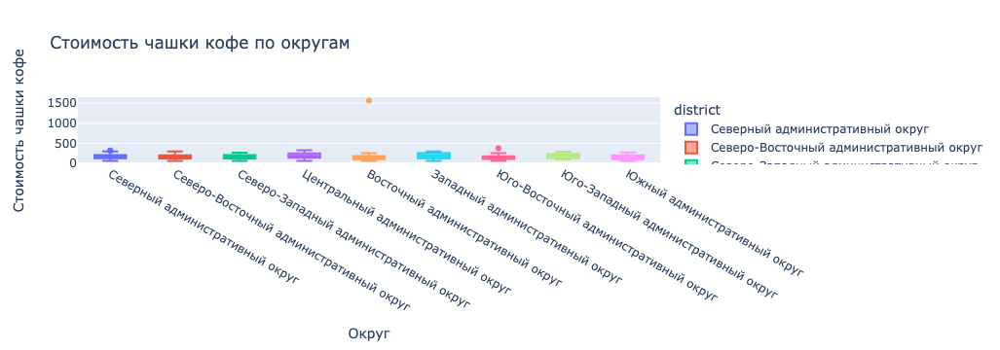

In [67]:
fig = px.box(coffee_house_cup, x='district', y='middle_coffee_cup', 
             color='district', 
             title = 'Стоимость чашки кофе по округам')

fig.update_layout(xaxis_title = 'Округ',
                  yaxis_title = 'Стоимость чашки кофе')

fig.show()

График получился неинформативный из-за выброса в Восточном округе. Избавимся от выбросов. Установим потолок цены чашки кофе - 450.

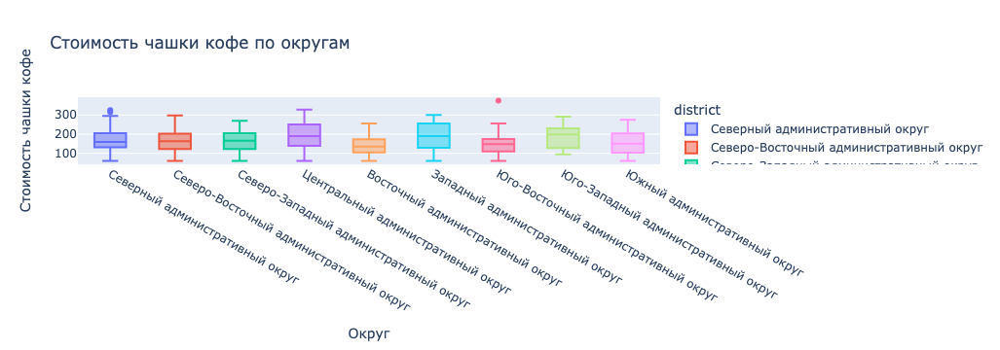

In [68]:
coffee_house_cup_2 = coffee_house_cup.query('middle_coffee_cup <= 450')

fig = px.box(coffee_house_cup_2, x='district', y='middle_coffee_cup', 
             color='district', 
             title = 'Стоимость чашки кофе по округам')

fig.update_layout(xaxis_title = 'Округ',
                  yaxis_title = 'Стоимость чашки кофе')

fig.show()

Отсортируем график стоимости чашки кофе по округам по медиане

In [69]:
rat_cup = coffee_house_cup_2[['district','middle_coffee_cup']]
rat_cup = rat_cup.pivot_table(
    index = rat_cup.index,
    columns = 'district',
    values = 'middle_coffee_cup')

sorted_index_3 = rat_cup.median().sort_values().index
cup_sorted=rat_cup[sorted_index_3]

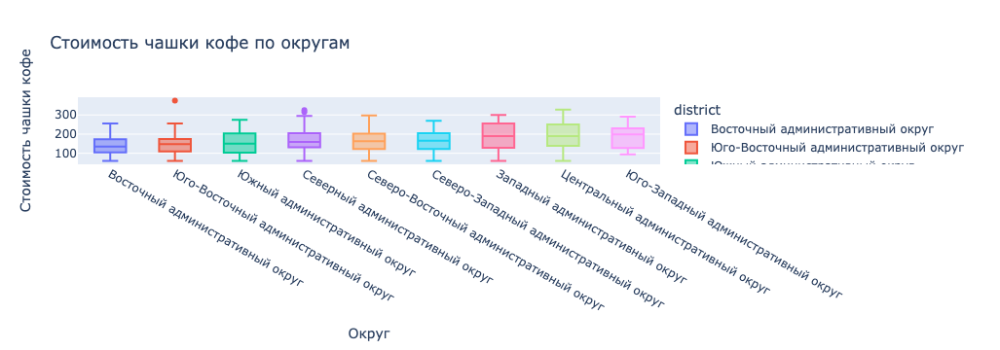

In [70]:
fig = px.box(cup_sorted, 
             color='district', 
             title = 'Стоимость чашки кофе по округам')

fig.update_layout(xaxis_title = 'Округ',
                  yaxis_title = 'Стоимость чашки кофе')

fig.show()

**Вывод**

В среднем, цена чашки кофе варьируется в районе от 140 до 220 рублей. Однако видна разница по округам. Самый дорогой кофе продают в ЦАО, ЗАО и ЮЗАО. Самый бюджетный в ВАО и ЮВАО.

### Рассмотрим, какое количество посадочных мест характерно для кофеен Москвы.

In [71]:
coffee_house_seats = coffee_house.query('seats.notnull()')

coffee_house_seats['seats'].describe()

count     751.000000
mean      111.199734
std       127.837772
min         0.000000
25%        40.000000
50%        80.000000
75%       144.000000
max      1288.000000
Name: seats, dtype: float64

In [72]:
coffee_house_seats.groupby('district').agg({'seats': 'describe'})

seats                               \
                                         count        mean         std  min   
district                                                                      
Восточный административный округ          45.0   97.444444  156.832939  0.0   
Западный административный округ           91.0  153.329670  205.286091  3.0   
Северный административный округ          110.0  117.281818  149.597695  0.0   
Северо-Восточный административный округ   83.0   92.132530   78.959973  0.0   
Северо-Западный административный округ    34.0   87.352941   71.329318  0.0   
Центральный административный округ       218.0  113.146789  103.207306  0.0   
Юго-Восточный административный округ      39.0   70.923077   65.192179  0.0   
Юго-Западный административный округ       56.0   86.607143   80.193103  0.0   
Южный административный округ              75.0  124.973333  121.969754  0.0   

                                                                      
                                           25%   50%     75%     max  
district                                                              
Восточный административный округ         42.00  55.0  100.00  1040.0  
Западный административный округ          50.00  96.0  180.00  1288.0  
Северный административный округ          30.00  66.0  140.00   625.0  
Северо-Восточный административный округ  37.00  75.0  120.00   350.0  
Северо-Западный административный округ   24.75  87.5  140.00   239.0  
Центральный административный округ       40.00  86.0  150.00   500.0  
Юго-Восточный административный округ     20.00  50.0  108.00   280.0  
Юго-Западный административный округ      40.00  64.5   99.25   491.0  
Южный административный округ             33.00  80.0  250.00   450.0

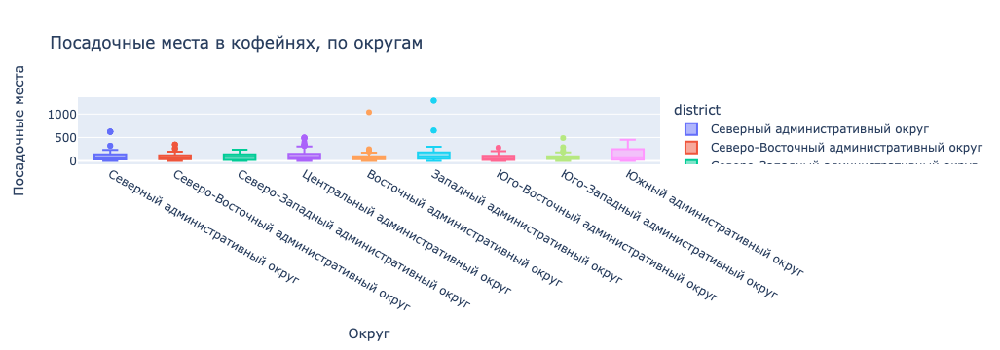

In [73]:
fig = px.box(coffee_house_seats, x='district', y='seats', 
             color='district', 
             title = 'Посадочные места в кофейнях, по округам')

fig.update_layout(xaxis_title = 'Округ',
                  yaxis_title = 'Посадочные места')

fig.show()

На графике заметны выбросы. Сложно представить кофейни на 500+ посадочных мест, не все банкетные залы могут таким похвастаться. Избавимся от выбросов.

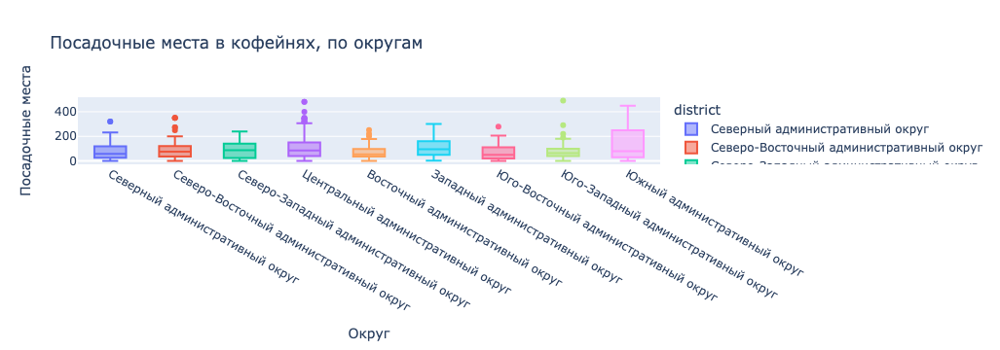

In [74]:
coffee_house_seats_2 = coffee_house_seats.query('seats < 500')

fig = px.box(coffee_house_seats_2, x='district', y='seats', 
             color='district', 
             title = 'Посадочные места в кофейнях, по округам')

fig.update_layout(xaxis_title = 'Округ',
                  yaxis_title = 'Посадочные места')

fig.show()

**Вывод:**

Медианное значение лежит в районе 80 посадочных мест. При этом медианы по округам рознятся от 50 до 96 посадочных мест.

### Вывод по шагу 4. Кофейни.

- Кофейни - популярный сегмент общепита в Москве. Они занимают 17% рынка общепита, что следует из данных, конкуренция достаточно высокая, поэтому при открытии новой кофейни следует обратить особое внимание на географическое расположение и концепцию заведения.
- Наибольшая концентрация кофеен наблюдается в ЦАО. В 2 и более раза кофеен меньше в других округах. Меньше всего кофеен в СЗАО и ЮВАО, это объясняется спецификой развития районирования Москвы.
- Круглосуточных кофеен крайне мало, примерно 4% от всех кофеен в датасете. Однако это не является возможностью, а скорее доказывает, что ночью кофейни не востребованы.
- Средняя оценка кофеен во всех округах выше 4. Больше всего негативных оценок наблюдается в СВАО, ЮВАО.
- В среднем, цена чашки кофе варьируется в районе от 140 до 220 рублей. Однако видна разница по округам. Самый дорогой кофе продают в ЦАО, ЗАО и ЮЗАО. Самый бюджетный в ВАО и ЮВАО.
- Количество посадочных мест варьируется от 50 до 96 посадочных мест. 

Таким образом, при открытии нового заведения, скорее не стоит ориентироваться на центр Москвы, так как концентрация слишком велика и конкуренция высокая. Придется конкурировать с сетями. Оптимальные варианты исходя из данных - СЗАО, ЮВАО, так как кофеен мало, а уровень средней цены кофе не является высоким. Медианные рейтинги кофеен в предложенных районах больше 4, однако есть и негативные отзывы, но поскольку кофеен мало, то стать заметной новой точкой вполне вероятно. Количество посадочных мест следует ограничить до 90.